In [1]:
import numpy as np
import pickle

In [2]:
from sklearn.datasets import load_iris
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import confusion_matrix
from scipy.stats import randint as sp_randint
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from time import time
import matplotlib.pyplot as plt

## Load the features

In [3]:
with open('../cache/features','rb') as f:
    X, y, imgNames = pickle.load(f)
X.shape

(598, 12)

In [17]:
X.head

,left_minus_right,mean,middle_max,middle_minus_left,middle_minus_right,middle_n_peaks,middle_prec_raised,middle_range,middle_row_max,pre_norm_max,pre_norm_range,pre_norm_var
0,0.001482,0.650116,0.884444,0.000092,0.001391,0.0,0.003094,0.600000,0.360000,225.0,202.0,111.677355
1,0.006381,0.619079,0.885572,0.002460,0.008841,8.0,0.245000,0.646766,0.527363,201.0,193.0,375.389887
2,0.003976,0.613970,0.973451,0.004476,0.008453,5.0,0.026719,0.730088,0.376106,226.0,199.0,235.528736
3,0.004076,0.552680,0.920000,0.001505,0.002571,11.0,0.167000,0.640000,0.426667,225.0,206.0,323.269721
4,0.002386,0.619940,0.768889,0.001501,0.000885,5.0,0.000281,0.586667,0.386667,209.0,190.0,202.834792


In [5]:
y.mean()

0.5635451505016722

## Evalutate a Decision Tree Model via Cross-Validation

In [6]:
from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(n_estimators=100).fit(X, y)

In [7]:
# Utility function to report best scores
def report(results, n_top=3):
    for i in range(1, n_top + 1):
        candidates = np.flatnonzero(results['rank_test_score'] == i)
        for candidate in candidates:
            print("Model with rank: {0}".format(i))
            print("Mean validation score: {0:.3f} (std: {1:.3f})".format(
                  results['mean_test_score'][candidate],
                  results['std_test_score'][candidate]))
            print("Parameters: {0}".format(results['params'][candidate]))
            print("")


In [8]:
param_dist = {"n_estimators": sp_randint(1, 200), 
              "max_depth": [3, 5, 7, None],
              "max_features": sp_randint(1, 11),
              "min_samples_split": sp_randint(2, 11),
              "bootstrap": [True, False],
              "criterion": ["gini", "entropy"]}

# run randomized search
n_iter_search = 200
random_search = RandomizedSearchCV(clf,
                                   param_distributions=param_dist,
                                   n_iter=n_iter_search, cv=5,)

In [9]:
start = time()
clf_rs = random_search.fit(X, y)
print("RandomizedSearchCV took %.2f seconds for %d candidates"
      " parameter settings." % ((time() - start), n_iter_search))
report(random_search.cv_results_)

/home/paul/.local/lib/python3.5/site-packages/sklearn/model_selection/_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


RandomizedSearchCV took 225.57 seconds for 200 candidates parameter settings.
Model with rank: 1
Mean validation score: 0.793 (std: 0.048)
Parameters: {'max_depth': 7, 'bootstrap': True, 'n_estimators': 146, 'criterion': 'entropy', 'max_features': 2, 'min_samples_split': 10}

Model with rank: 2
Mean validation score: 0.791 (std: 0.040)
Parameters: {'max_depth': None, 'bootstrap': True, 'n_estimators': 172, 'criterion': 'gini', 'max_features': 4, 'min_samples_split': 4}

Model with rank: 3
Mean validation score: 0.789 (std: 0.031)
Parameters: {'max_depth': None, 'bootstrap': True, 'n_estimators': 75, 'criterion': 'gini', 'max_features': 1, 'min_samples_split': 2}



In [10]:
best_model = clf_rs.best_estimator_

In [11]:
scores = cross_val_score(best_model, X, y, cv=10)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Accuracy: 0.78 (+/- 0.12)


In [12]:
y_pred = cross_val_predict(best_model, X, y, cv=10)
confusion_matrix(y, y_pred)

array([[194,  67],
       [ 69, 268]])

Feature ranking:
1. feature left_minus_right (0.148091)
2. feature mean (0.142087)
3. feature middle_max (0.102302)
4. feature middle_minus_left (0.085028)
5. feature middle_minus_right (0.083601)
6. feature middle_n_peaks (0.077857)
7. feature middle_prec_raised (0.071327)
8. feature middle_range (0.070103)
9. feature middle_row_max (0.064402)
10. feature pre_norm_max (0.063832)
11. feature pre_norm_range (0.062691)
12. feature pre_norm_var (0.028679)


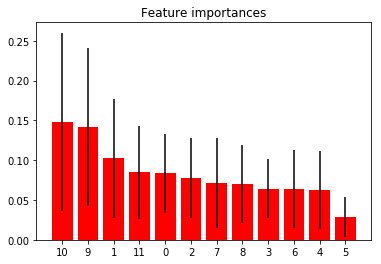

In [13]:
importances = best_model.feature_importances_
std = np.std([tree.feature_importances_ for tree in best_model.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")
for f in range(X.shape[1]):
    print("%d. feature %s (%f)" % (f + 1, X.columns[f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(X.columns[indices], importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]), indices)
plt.xlim([-1, X.shape[1]])
plt.show()

## Look at bad examples

In [14]:
from PIL import Image
import imageio

def printWaterfall(file):
    im = imageio.imread(file)
    display(Image.fromarray(im))

     left_minus_right      mean  middle_max  middle_minus_left  \
124           0.00074  0.531119    0.977143           0.000257   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
124            0.000998            23.0             0.36825          0.84   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
124        0.651429         175.0           172.0     641.32371  


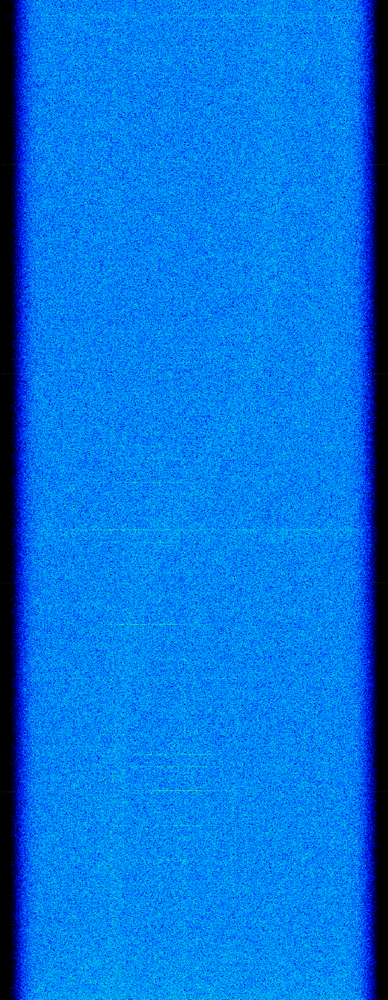

     left_minus_right      mean  middle_max  middle_minus_left  \
113          0.007736  0.821693    0.995595           0.001186   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
113             0.00655             1.0                 0.0      0.634361   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
113         0.45815         226.0           151.0    303.712133  


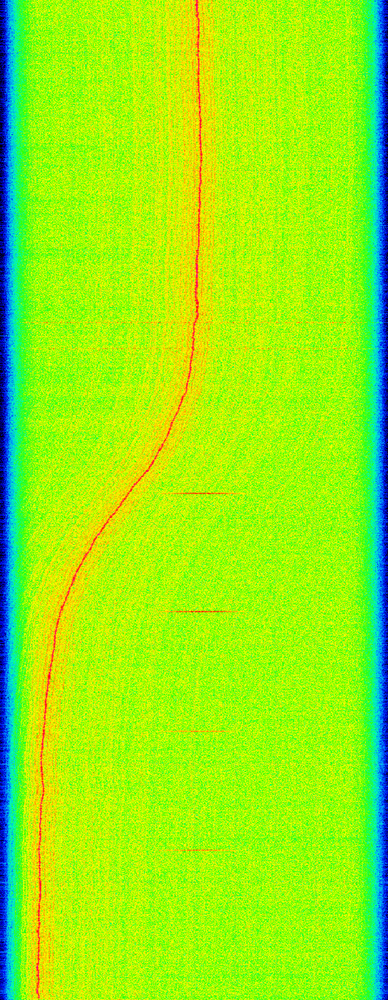

     left_minus_right      mean  middle_max  middle_minus_left  \
223          0.006671  0.682821    0.893939           0.003441   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
223             0.00323             4.0            0.067937      0.479798   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
223        0.474747         198.0           176.0    254.965448  


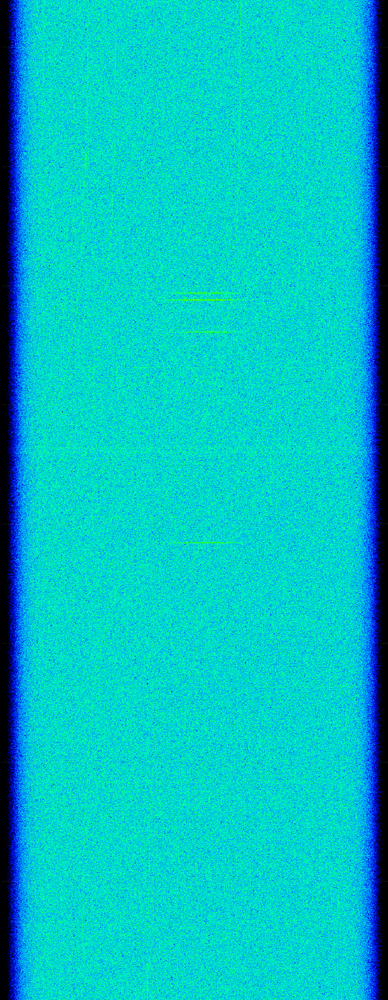

   left_minus_right      mean  middle_max  middle_minus_left  \
8          0.002007  0.673598    0.813084           0.000946   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
8            0.001061             1.0            0.000531      0.397196   

   middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
8        0.434579         200.0           176.0    141.411245  


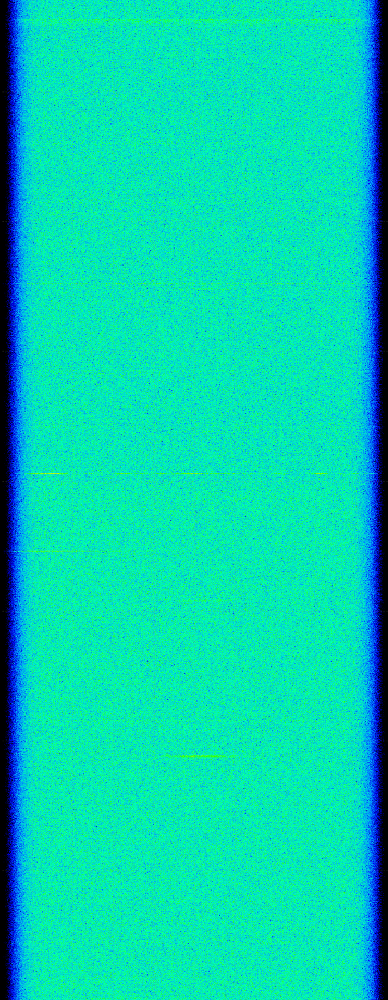

    left_minus_right     mean  middle_max  middle_minus_left  \
90          0.002582  0.70969    0.977273           0.002276   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
90            0.000306            12.0             0.17825      0.772727   

    middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
90        0.590909         175.0           160.0     366.47445  


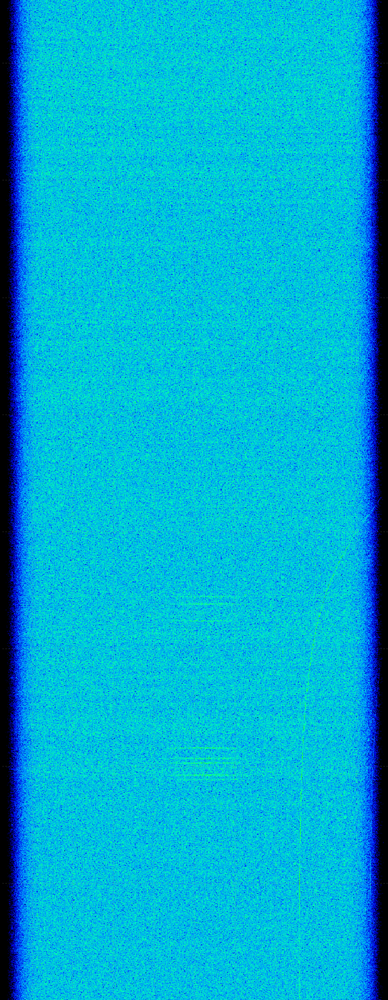

In [15]:
is_false_negative = np.where(np.logical_and(y == 1, y_pred == 0))[0]
for idx in np.random.choice(is_false_negative, 5):
    print(X.iloc[[idx]])
    printWaterfall('../data/cropped/good/' + imgNames[idx])

   left_minus_right      mean  middle_max  middle_minus_left  \
7          0.014074  0.601046    0.933628           0.013336   

   middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
7            0.000738             1.0            0.032875      0.606195   

   middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
7        0.402655         226.0           209.0    257.484165  


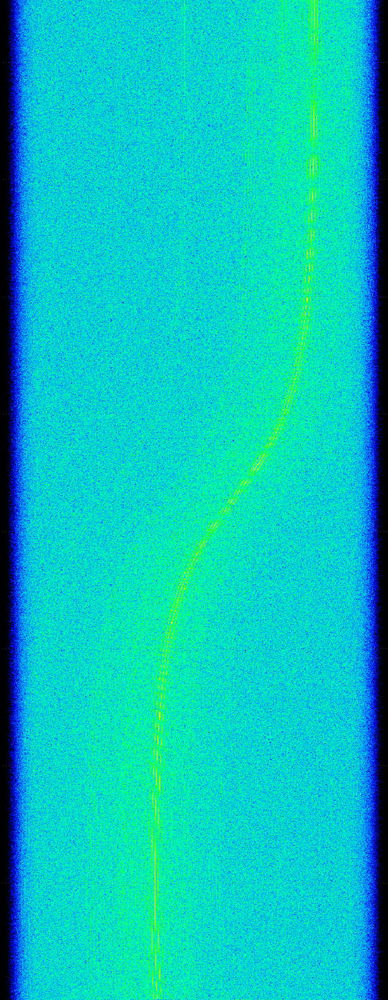

    left_minus_right      mean  middle_max  middle_minus_left  \
63          0.002374  0.703787    0.982301           0.001285   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
63            0.001089             1.0            0.011344      0.389381   

    middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
63        0.247788         226.0           121.0     66.148786  


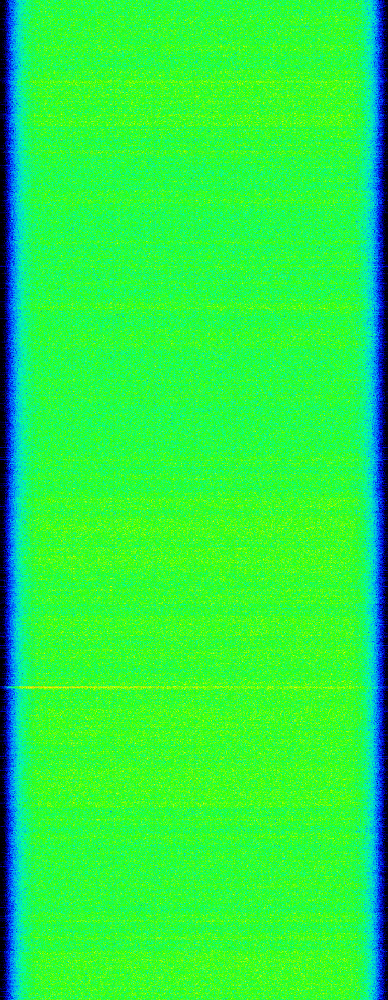

     left_minus_right      mean  middle_max  middle_minus_left  \
129          0.002332  0.531103    0.943182           0.002192   

     middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
129             0.00014            20.0             0.37575      0.835227   

     middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
129          0.6875         174.0           172.0    636.211342  


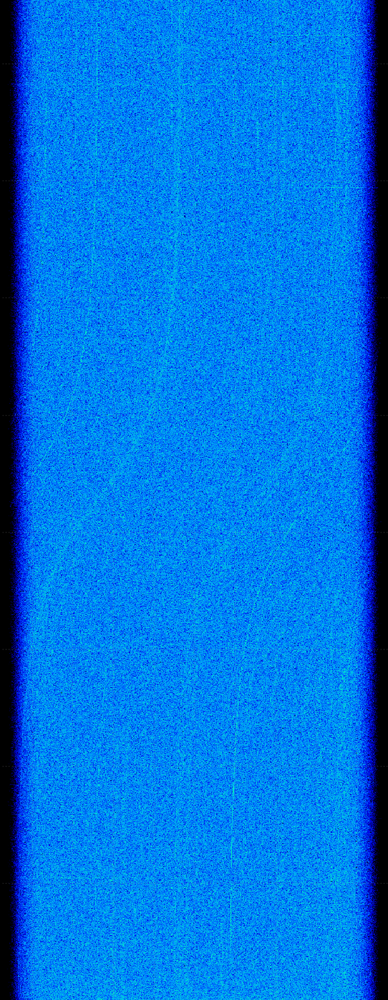

    left_minus_right      mean  middle_max  middle_minus_left  \
75          0.000989  0.695721    0.955752           0.000583   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
75            0.000406             1.0               0.008      0.371681   

    middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
75        0.238938         225.0           166.0     47.517714  


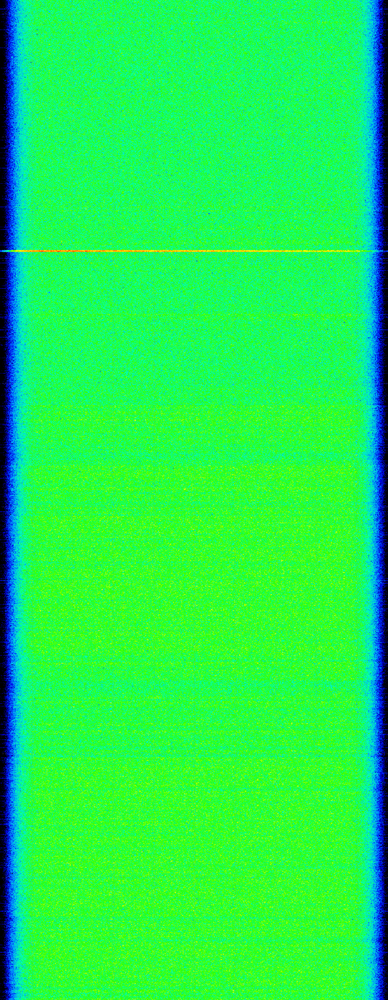

    left_minus_right      mean  middle_max  middle_minus_left  \
89          0.003975  0.652145    0.822222           0.000564   

    middle_minus_right  middle_n_peaks  middle_prec_raised  middle_range  \
89            0.003412             0.0            0.000531      0.506667   

    middle_row_max  pre_norm_max  pre_norm_range  pre_norm_var  
89        0.333333         207.0           178.0    116.463036  


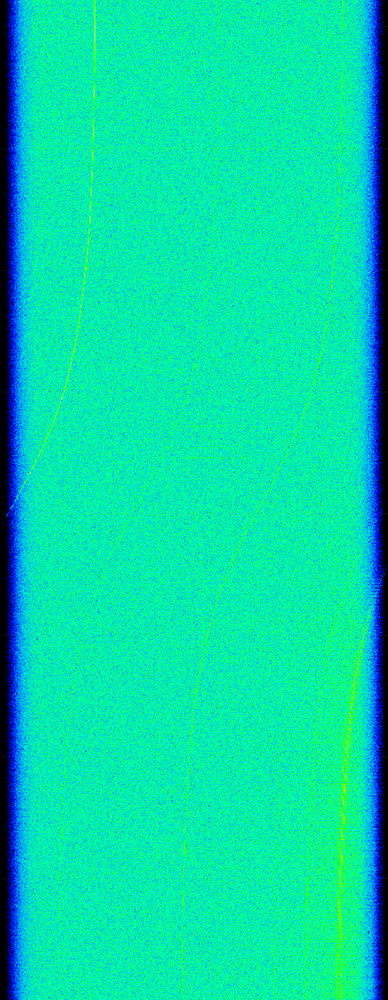

In [16]:
is_false_positive = np.where(np.logical_and(y == 0, y_pred == 1))[0]
for idx in np.random.choice(is_false_positive, 5):
    print(X.iloc[[idx]])
    printWaterfall('../data/cropped/bad/' + imgNames[idx])